# MedCare Wellness Research Center - Predicting Physical Health

**Objective**: Perform exploratory data analysis (EDA), preprocess the dataset, and predict the "Physical Health" feature. The analysis involves defining whether the problem is regression, classification, or clustering, testing multiple models, and selecting the best model using cross-validation.

---

## 1. Importing Libraries

In this section, we import the necessary Python libraries for data analysis, visualization, and machine learning. Here's the code for importing these libraries:

```python
import pandas as pd  # For data manipulation and analysis
import numpy as np  # For numerical operations and array handling
import seaborn as sns  # For statistical data visualization with improved aesthetics
import plotly.express as px  # For interactive data visualization
import matplotlib.pyplot as plt  # For creating static, animated, and interactive plots
from sklearn.model_selection import train_test_split, RandomizedSearchCV  # For splitting data and hyperparameter tuning
from sklearn.preprocessing import LabelEncoder, StandardScaler  # For encoding categorical variables and feature scaling
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor  # For ensemble regression models
from sklearn.linear_model import LinearRegression  # For linear regression modeling
from sklearn.metrics import mean_squared_error, r2_score  # For evaluating model performance
import scipy.stats as zscore  # For statistical functions, such as outlier detection
import warnings  # For managing warnings
warnings.filterwarnings('ignore')  # Suppressing warnings for cleaner output

In [74]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import scipy.stats as zscore
import warnings
warnings.filterwarnings('ignore')


## 2. Loading the Dataset


In [36]:
# Load the dataset
df = pd.read_csv('medcenter.csv')
df.head()


,Walking Difficulty,Torsades de Pointes,Skin Cancer,Hours of sleep,How do you Feel,Asthma Status,Do you Exercise,Gender,Kidney Disease,Is Smoking,Ethnicity,Diabetes,How many Drinks per Week,Age Group,Mental Health,Body Mass Index,Physical Health,History of Stroke,Patient ID
0,Y,Y,N,10.0,Good,N,Y,F,N,Y,White,N,N,80 or older,0.0,15.55,7.0,Y,100074
1,N,Y,N,7.0,Fair,Y,N,F,N,N,White,Y,N,65-69,0.0,38.62,2.0,N,100086
2,N,Y,N,7.0,Good,N,N,M,N,N,White,N,N,60-64,0.0,21.62,3.0,N,100094
3,Y,Y,N,8.0,Good,N,N,F,N,Y,White,N,N,65-69,0.0,22.14,0.0,N,100154
4,Y,Y,N,8.0,Fair,N,Y,M,Y,N,White,Y,N,70-74,0.0,43.05,0.0,N,100158


### Dataset Features

The dataset contains records of elderly individuals with various health metrics and lifestyle attributes:

- **Walking Difficulty**: Y/N indicating if the individual has difficulty walking.
- **Torsades de Pointes**: Y/N indicating the presence of a specific type of abnormal heart rhythm.
- **Skin Cancer**: Y/N indicating if the individual has/had skin cancer.
- **Hours of Sleep**: Average number of hours the individual sleeps per night.
- **How do you Feel**: Self-reported feeling about health (Poor, Fair, Good, Very good, Excellent).
- **Asthma Status**: Y/N indicating if the individual has asthma.
- **Do you Exercise**: Y/N indicating if the individual exercises regularly.
- **Gender**: Gender of the individual (M for Male, F for Female).
- **Kidney Disease**: Y/N indicating if the individual has kidney disease.
- **Is Smoking**: Y/N indicating if the individual smokes.
- **Ethnicity**: Ethnic group the individual identifies with (e.g., White, Black, etc.).
- **Diabetes**: Y/N indicating if the individual has diabetes.
- **How many Drinks per Week**: Number of alcoholic beverages consumed per week.
- **Age Group**: Age bracket (e.g., 65-69, 70-74).
- **Mental Health**: Score indicating mental health status (higher is better).
- **Body Mass Index (BMI)**: Measure estimating body fat based on weight and height.
- **Physical Health**: Score indicating physical health status (higher is better).
- **History of Stroke**: Y/N indicating if the individual has had a stroke.
- **Patient ID**: Unique identifier for each individual.


## 3. Exploratory Data Analysis (EDA)

Let's explore the dataset with summary statistics and visualizations.


In [37]:
# Summary statistics
df.describe()

,Hours of sleep,Mental Health,Body Mass Index,Physical Health,Patient ID
count,261311.000000,261311.000000,261311.000000,261311.000000,261311.000000
mean,7.099406,3.907199,28.355734,3.474951,549563.630153
std,1.446752,7.969255,6.361975,8.079793,259779.193866
min,1.000000,0.000000,12.020000,0.000000,100006.000000
25%,6.000000,0.000000,24.030000,0.000000,324810.500000
50%,7.000000,0.000000,27.350000,0.000000,549753.000000
75%,8.000000,3.000000,31.470000,2.000000,774317.500000
max,24.000000,30.000000,94.850000,30.000000,999997.000000


## Statistics Analysis

### Hours of Sleep:

- **Count**: 261,311 entries.
- **Mean**: The average number of hours of sleep is approximately 7.10 hours.
- **Std Dev**: The standard deviation is 1.45 hours, indicating variability in sleep duration.
- **Min**: The minimum recorded sleep is 1 hour.
- **25%**: 25% of individuals sleep 6 hours or less.
- **50%**: The median (50th percentile) is 7 hours.
- **75%**: 75% of individuals sleep 8 hours or less.
- **Max**: The maximum recorded sleep is 24 hours.

### Mental Health:

- **Count**: 261,311 entries.
- **Mean**: The average mental health score is 3.91.
- **Std Dev**: The standard deviation is 7.97, showing a wide spread in mental health scores.
- **Min**: The minimum score is 0.
- **25%**: 25% of individuals have a score of 0.
- **50%**: The median score is 0.
- **75%**: 75% of individuals have a score of 3 or less.
- **Max**: The maximum score is 30.

### Body Mass Index (BMI):

- **Count**: 261,311 entries.
- **Mean**: The average BMI is 28.36.
- **Std Dev**: The standard deviation is 6.36, reflecting variability in BMI.
- **Min**: The minimum BMI recorded is 12.02.
- **25%**: 25% of individuals have a BMI of 24.03 or less.
- **50%**: The median BMI is 27.35.
- **75%**: 75% of individuals have a BMI of 31.47 or less.
- **Max**: The maximum BMI recorded is 94.85.

### Physical Health:

- **Count**: 261,311 entries.
- **Mean**: The average physical health score is 3.47.
- **Std Dev**: The standard deviation is 8.08, indicating variability in physical health scores.
- **Min**: The minimum score is 0.
- **25%**: 25% of individuals have a score of 0.
- **50%**: The median score is 0.
- **75%**: 75% of individuals have a score of 2 or less.
- **Max**: The maximum score is 30.

### Patient ID:

- **Count**: 261,311 entries.
- **Mean**: The average patient ID is 549,563.63.
- **Std Dev**: The standard deviation is 259,779.19, reflecting variability in the IDs.
- **Min**: The minimum patient ID is 100,006.
- **25%**: 25% of patient IDs are 324,810.50 or less.
- **50%**: The median patient ID is 549,753.00.
- **75%**: 75% of patient IDs are 774,317.50 or less.
- **Max**: The maximum patient ID is 999,997.00.


In [38]:
df.describe(include='object').T

,count,unique,top,freq
Walking Difficulty,261311,2,N,223688
Torsades de Pointes,261311,2,N,233938
Skin Cancer,261311,2,N,236336
How do you Feel,261311,5,Very good,92342
Asthma Status,261311,2,N,226040
Do you Exercise,261311,2,Y,201862
Gender,261311,2,F,136474
Kidney Disease,261311,2,N,251215
Is Smoking,261311,2,N,152475
Ethnicity,261311,6,White,200780


## Categorical Features 

The following table summarizes the categorical features in the dataset. For each feature, it provides the count of entries, the number of unique categories, the most frequent category (`top`), and the frequency of this most frequent category (`freq`).

| Feature                     | Count  | Unique | Top          | Freq   |
|-----------------------------|--------|--------|--------------|--------|
| **Walking Difficulty**      | 261,311| 2      | N            | 223,688|
| **Torsades de Pointes**     | 261,311| 2      | N            | 233,938|
| **Skin Cancer**             | 261,311| 2      | N            | 236,336|
| **How do you Feel**         | 261,311| 5      | Very good    | 92,342 |
| **Asthma Status**           | 261,311| 2      | N            | 226,040|
| **Do you Exercise**         | 261,311| 2      | Y            | 201,862|
| **Gender**                  | 261,311| 2      | F            | 136,474|
| **Kidney Disease**          | 261,311| 2      | N            | 251,215|
| **Is Smoking**              | 261,311| 2      | N            | 152,475|
| **Ethnicity**               | 261,311| 6      | White         | 200,780|
| **Diabetes**                | 261,311| 4      | N            | 219,224|
| **How many Drinks per Week**| 261,311| 2      | N            | 243,614|
| **Age Group**               | 261,311| 13     | 65-69        | 28,202 |
| **History of Stroke**       | 261,311| 2      | N            | 250,754|

### Explanation:

- **Walking Difficulty**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 223,688 times.

- **Torsades de Pointes**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 233,938 times.

- **Skin Cancer**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 236,336 times.

- **How do you Feel**:
  - **Count**: 261,311 entries.
  - **Unique**: 5 unique categories.
  - **Top**: The most common category is `Very good`.
  - **Freq**: `Very good` occurs 92,342 times.

- **Asthma Status**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 226,040 times.

- **Do you Exercise**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `Y` (Yes).
  - **Freq**: `Y` occurs 201,862 times.

- **Gender**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `F` (Female).
  - **Freq**: `F` occurs 136,474 times.

- **Kidney Disease**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 251,215 times.

- **Is Smoking**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 152,475 times.

- **Ethnicity**:
  - **Count**: 261,311 entries.
  - **Unique**: 6 unique categories.
  - **Top**: The most common category is `White`.
  - **Freq**: `White` occurs 200,780 times.

- **Diabetes**:
  - **Count**: 261,311 entries.
  - **Unique**: 4 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 219,224 times.

- **How many Drinks per Week**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 243,614 times.

- **Age Group**:
  - **Count**: 261,311 entries.
  - **Unique**: 13 unique categories.
  - **Top**: The most common age group is `65-69`.
  - **Freq**: `65-69` occurs 28,202 times.

- **History of Stroke**:
  - **Count**: 261,311 entries.
  - **Unique**: 2 unique categories.
  - **Top**: The most common category is `N` (No).
  - **Freq**: `N` occurs 250,754 times.


In [39]:
# Data Info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 261311 entries, 0 to 261310
Data columns (total 19 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Walking Difficulty        261311 non-null  object 
 1   Torsades de Pointes       261311 non-null  object 
 2   Skin Cancer               261311 non-null  object 
 3   Hours of sleep            261311 non-null  float64
 4   How do you Feel           261311 non-null  object 
 5   Asthma Status             261311 non-null  object 
 6   Do you Exercise           261311 non-null  object 
 7   Gender                    261311 non-null  object 
 8   Kidney Disease            261311 non-null  object 
 9   Is Smoking                261311 non-null  object 
 10  Ethnicity                 261311 non-null  object 
 11  Diabetes                  261311 non-null  object 
 12  How many Drinks per Week  261311 non-null  object 
 13  Age Group                 261311 non-null  o

## Dataset Structure

The dataset contains 261,311 entries with 19 columns. Below is a summary of the data types and non-null counts for each column:

| Column                     | Non-Null Count | Data Type |
|----------------------------|----------------|-----------|
| **Walking Difficulty**     | 261,311        | object    |
| **Torsades de Pointes**    | 261,311        | object    |
| **Skin Cancer**            | 261,311        | object    |
| **Hours of Sleep**         | 261,311        | float64   |
| **How do you Feel**        | 261,311        | object    |
| **Asthma Status**          | 261,311        | object    |
| **Do you Exercise**        | 261,311        | object    |
| **Gender**                 | 261,311        | object    |
| **Kidney Disease**         | 261,311        | object    |
| **Is Smoking**             | 261,311        | object    |
| **Ethnicity**              | 261,311        | object    |
| **Diabetes**               | 261,311        | object    |
| **How many Drinks per Week** | 261,311      | object    |
| **Age Group**              | 261,311        | object    |
| **Mental Health**          | 261,311        | float64   |
| **Body Mass Index**        | 261,311        | float64   |
| **Physical Health**        | 261,311        | float64   |
| **History of Stroke**      | 261,311        | object    |
| **Patient ID**             | 261,311        | int64     |

### Explanation:

- **Object**: Categorical data, usually represented as strings. Columns of this type include various categorical features such as `Walking Difficulty`, `Torsades de Pointes`, and `Ethnicity`.
  
- **Float64**: Numerical data with decimal values. Columns of this type include `Hours of Sleep`, `Mental Health`, `Body Mass Index`, and `Physical Health`.

- **Int64**: Integer data. The column `Patient ID` is of this type, representing unique identifiers for each individual.

The dataset is well-structured with no missing values across any columns, as indicated by the uniform non-null counts.


In [40]:
# Total rows and columns
rows, columns = df.shape
print(f'Total rows: {rows}')
print(f'Total columns: {columns}')

Total rows: 261311
Total columns: 19


In [41]:
# Checking for missing values
df.isnull().sum()

Walking Difficulty          0
Torsades de Pointes         0
Skin Cancer                 0
Hours of sleep              0
How do you Feel             0
Asthma Status               0
Do you Exercise             0
Gender                      0
Kidney Disease              0
Is Smoking                  0
Ethnicity                   0
Diabetes                    0
How many Drinks per Week    0
Age Group                   0
Mental Health               0
Body Mass Index             0
Physical Health             0
History of Stroke           0
Patient ID                  0
dtype: int64


All columns in the dataset have zero missing values, indicating that the data is complete and there are no gaps in the information provided.

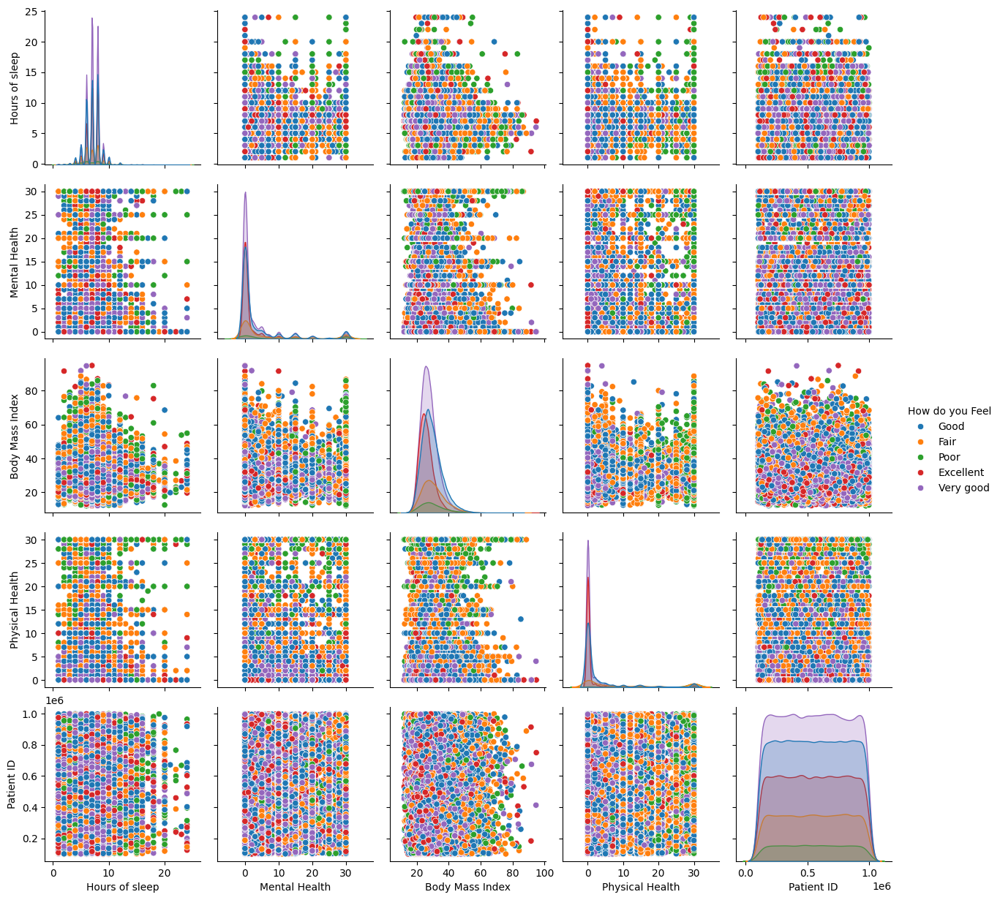

In [42]:
# Pairplot to visualize relationships between numerical features
sns.pairplot(df, hue='How do you Feel')
plt.show()

## Interpretation of Pairplots

* **Diagonal plots:** Show the distribution of each numerical feature using histograms.
* **Lower triangular plots:** Depict scatter plots, visualizing relationships between two numerical features.
* **Color coding:** Reflects categorical data in the 'How do you Feel' column.
* **Pattern identification:** Helps identify linear trends, non-linear associations, and potential outliers.

## 4. Preprocessing the Data


### a. Removing Outliers
We'll use the Z-score method to detect and remove outliers.

In [46]:
def remove_outliers(df):
    # check numerical columns
    num_cols = df.select_dtypes(include='number').columns
    z_scores = zscore.zscore(df[num_cols])
    abs_z_scores = np.abs(z_scores)
    filtered_entries = (abs_z_scores < 3).all(axis=1)
    new_df = df[filtered_entries]
    return new_df

# # remove patient id column
df.drop('Patient ID', axis=1, inplace=True)

df = remove_outliers(df)

## Outlier Removal 

The code defines a function `remove_outliers(df)` that removes outliers from the DataFrame `df` using the Z-score method. 

1. **Numerical Columns**: The function selects numerical columns from `df`.
2. **Z-scores**: It calculates Z-scores to measure how far data points are from the mean.
3. **Filtering**: Data points with Z-scores greater than or equal to 3 are considered outliers and excluded.
4. **New DataFrame**: The cleaned DataFrame `new_df` is returned, with outliers removed.

The 'Patient ID' column is also dropped before applying the outlier removal function. The cleaned DataFrame is then updated with the outliers removed.


In [47]:
# rows and columns after removing outliers
rows, columns = df.shape
print(f'Total rows: {rows}')
print(f'Total columns: {columns}')

Total rows: 228381
Total columns: 18



**Before Removing Outliers:**
- Total rows: 261,311
- Total columns: 19

**After Removing Outliers:**
- Total rows: 228,381
- Total columns: 18

The data cleaning process reduced the number of rows by 32,930 and the number of columns by 1, effectively removing outliers and adjusting the dataset for further analysis.


---

## 5. Data Visualization
- Data visualization helps us understand the relationships between features and the target variable.


1. Distribution of the Target Variable ("Physical Health")

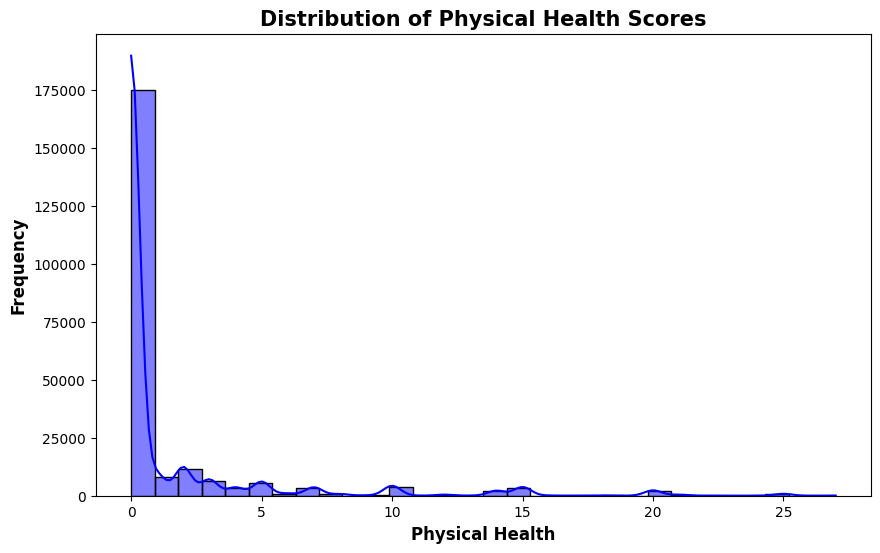

In [50]:
plt.figure(figsize=(10, 6))
sns.histplot(df['Physical Health'], kde=True, color='blue', bins=30, edgecolor='black')
plt.title('Distribution of Physical Health Scores', fontsize=15, fontweight='bold', color='black')
plt.xlabel('Physical Health', fontsize=12, fontweight='bold', color='black')
plt.ylabel('Frequency', fontsize=12, fontweight='bold', color='black')
plt.show()

## Histogram of Physical Health Scores

The histogram below shows the distribution of the 'Physical Health' scores in the dataset. 

- **KDE Plot**: A Kernel Density Estimate (KDE) curve is overlaid to illustrate the distribution shape.
- **Bins**: The histogram is divided into 30 bins to capture the frequency distribution of the scores.
- **Color**: The bars are colored blue with a black edge to enhance visibility.

The plot helps in understanding the spread and frequency of physical health scores within the dataset.


## Interpretation of Physical Health Scores Distribution

The provided histogram illustrates the distribution of physical health scores. Here are some key observations:

**Skewness:** The distribution is heavily skewed to the right, indicating that a majority of respondents reported lower physical health scores, while a smaller number reported significantly higher scores.

**Peak:** The distribution peaks between 0 and 5, suggesting that the most frequent range of physical health scores falls within this interval.

**Frequency:** The frequency of scores decreases as the physical health score increases, implying that fewer respondents reported higher levels of physical health.

**Overall:** The distribution suggests that physical health scores are concentrated towards the lower end of the spectrum, with a long tail extending towards higher scores. This indicates that while many individuals reported relatively poor physical health, there is a smaller subset reporting excellent physical health.

---

2. Distribution of Categorical Variables (e.g., Gender)

In [51]:
fig = px.pie(df, names='Gender', title='Distribution of Gender', hole=0.5, color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_traces(textinfo='percent+label', pull=[0.1, 0], textfont_size=15, marker=dict(line=dict(color='black', width=2)))
fig.show()


## Interpretation of Gender Distribution

The provided donut chart illustrates the distribution of gender within a given dataset. Here are the key observations:

**Female vs. Male:**

- **Female:** 51.4% of the individuals in the dataset are female.
- **Male:** 48.6% of the individuals are male.

**Overall:**

- The gender distribution is relatively balanced, with a slight majority of females. 
- This suggests that the dataset represents a fairly diverse population in terms of gender.

---

3. Bar Chart of the Average Physical Health by Ethnicity

In [60]:
ethnicity_health = df.groupby('Ethnicity')['Physical Health'].mean().reset_index()
fig = px.bar(ethnicity_health, x='Ethnicity', y='Physical Health', color='Physical Health',
             title='Average Physical Health by Ethnicity', color_continuous_scale='RdBu', text='Physical Health')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside', marker_line_color='black',   marker_line_width=1.5)
fig.show()


## Interpretation of Average Physical Health by Ethnicity

The provided bar chart illustrates the average physical health scores across different ethnic groups. Here are the key observations:

**Highest Average Physical Health:**

- **American Indian/Alaskan Native:** This group reports the highest average physical health score of 1.99, indicating the best overall physical well-being among the ethnicities represented.

**Lowest Average Physical Health:**

- **Asian:** This group reports the lowest average physical health score of 0.87, suggesting that individuals in this group generally experience poorer physical health compared to others.

**Other Ethnic Groups:**

- **Black, Hispanic, Other, and White:** These groups exhibit average physical health scores ranging from 1.4 to 1.7, indicating moderate levels of physical well-being.

**Overall:**

- There are significant disparities in average physical health across different ethnicities.
- American Indian/Alaskan Native individuals report notably higher levels of physical health compared to Asian individuals.
- Further investigation is needed to understand the underlying factors contributing to these disparities and to develop targeted interventions to improve physical health outcomes for all ethnic groups.

---

4. Violin Plot to Analyze the Distribution of Hours of Sleep

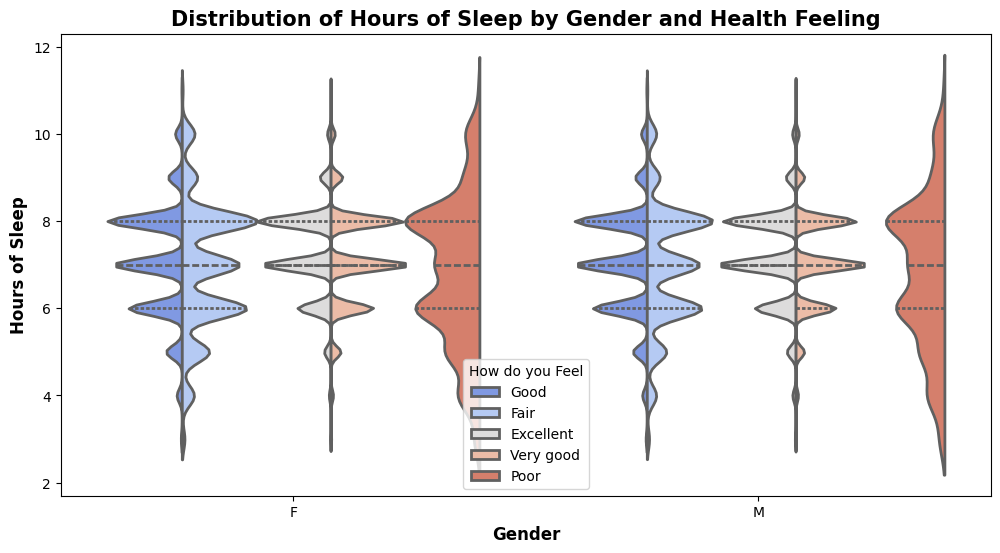

In [62]:
plt.figure(figsize=(12, 6))
sns.violinplot(x='Gender', y='Hours of sleep', hue='How do you Feel', data=df, split=True, palette='coolwarm', inner='quartile', linewidth=2, scale='count')
plt.title('Distribution of Hours of Sleep by Gender and Health Feeling', fontsize=15, fontweight='bold', color='black')
plt.xlabel('Gender', fontsize=12, fontweight='bold', color='black')
plt.ylabel('Hours of Sleep', fontsize=12, fontweight='bold', color='black')
plt.show()


## Interpretation of Hours of Sleep by Gender and Health Feeling

The provided violin plot illustrates the distribution of hours of sleep across different gender and health feeling categories. Here are the key observations:

**Gender Differences:**

- **Females:** The violin plot for females shows a generally higher median hours of sleep compared to males, with the distribution extending further to the right. This suggests that females tend to sleep more than males.
- **Males:** The violin plot for males indicates a lower median hours of sleep compared to females, with a more compact distribution. This suggests that males generally sleep less than females.

**Health Feeling and Sleep:**

- **Good, Fair, Excellent, Very good:** These categories exhibit similar distributions of hours of sleep, with a median around 7-8 hours. This suggests that individuals reporting these health feelings tend to sleep a moderate amount.
- **Poor:** This category shows a slightly wider distribution of hours of sleep, with a median slightly lower than the other categories. This indicates that individuals reporting poor health may experience more variability in their sleep patterns.

**Overall:**

- There is a clear gender difference in hours of sleep, with females tending to sleep more than males.
- Health feeling does not appear to have a strong influence on the distribution of hours of sleep, although individuals reporting poor health may exhibit slightly different sleep patterns.
- Further analysis could explore the relationship between sleep duration and other factors such as age, occupation, and stress levels.

---

5. Scatter Plot of Body Mass Index (BMI) vs Physical Health


In [65]:
fig = px.scatter(df, x='Body Mass Index', y='Physical Health', color='Gender',
                 title='BMI vs Physical Health Colored by Gender', size='Mental Health',
                 hover_data=['Age Group'])
fig.update_traces(marker=dict(size=12, line=dict(width=2, color='black')), selector=dict(mode='markers'), textfont_size=12, textposition='top center')
fig.show()


## Interpretation of BMI vs. Physical Health Colored by Gender

This scatter plot presents the relationship between Body Mass Index (BMI) and Physical Health, with gender distinction using color coding and marker size representing Mental Health. Age group information is included in the hover data for each point.

**Key Observations:**

* **Scatter Pattern:** There's a weak negative correlation between BMI and Physical Health. This indicates that individuals with higher BMI tend to report lower Physical Health scores, but the association is not very strong. There are data points scattered throughout the plot, suggesting significant variability in the relationship.
* **Gender Differences:** The color coding by gender reveals some potential trends. While the overall pattern holds for both genders, there might be subtle differences in the distribution of data points within each color group. Further analysis could be conducted to investigate these potential gender-based variations.
* **Mental Health as Marker Size:** The size of the markers reflects Mental Health scores. While the exact relationship isn't visually evident from marker size alone, it might be useful to explore how Mental Health interacts with BMI and Physical Health through statistical testing or other data visualization techniques.

**Additional Considerations:**

* The hover data containing Age Group information can provide further insights when examining specific data points on the scatter plot.
* It's important to acknowledge that correlation doesn't imply causation. Other factors besides BMI might influence Physical Health.

**Overall:**

This scatter plot suggests a potential link between BMI and Physical Health, with some variation based on gender and possibly Mental Health. Further analysis is recommended to explore these relationships in more detail and identify any underlying causal factors.

---

6. Stacked Bar Plot for Lifestyle Habits (e.g., Smoking)

In [67]:
lifestyle_df = df.groupby(['Is Smoking', 'Do you Exercise'])['Physical Health'].mean().reset_index()
fig = px.bar(lifestyle_df, x='Is Smoking', y='Physical Health', color='Do you Exercise',
             title='Impact of Smoking and Exercise on Physical Health', text='Physical Health', barmode='group', color_discrete_sequence=px.colors.sequential.RdBu)
fig.show()


## Interpretation of Impact of Smoking and Exercise on Physical Health

The provided bar chart illustrates the average physical health scores across different combinations of smoking and exercise habits. Here are the key observations:

**Smoking and Physical Health:**

- **Non-smokers who exercise (N-Y):** This group reports the highest average physical health score of 2.79, indicating the best overall physical well-being.
- **Non-smokers who don't exercise (N-N):** This group has a lower average physical health score of 2.13, suggesting that exercise is beneficial for physical health even among non-smokers.
- **Smokers who exercise (Y-Y):** This group's average physical health score is 1.46, which is lower than non-smokers who exercise but higher than smokers who don't exercise. This suggests that exercise can partially mitigate the negative impact of smoking on physical health.
- **Smokers who don't exercise (Y-N):** This group reports the lowest average physical health score of 1.09, highlighting the detrimental effects of both smoking and lack of exercise on physical health.

**Overall:**

- The chart clearly demonstrates that both smoking and lack of exercise have negative impacts on physical health.
- Combining smoking with a sedentary lifestyle results in the worst physical health outcomes.
- Regular exercise can improve physical health, even among smokers, but it cannot completely counteract the harmful effects of smoking.

**Conclusion:**

To achieve optimal physical health, it is crucial to avoid smoking and maintain an active lifestyle. Quitting smoking and engaging in regular exercise can significantly improve physical well-being.

---

### Handling Categorical Features with LabelEncoder

In [68]:
LabelEncoder = LabelEncoder()

# Encoding categorical variables
for col in df.select_dtypes(include='object'):
    df[col] = LabelEncoder.fit_transform(df[col])

df.head()

,Walking Difficulty,Torsades de Pointes,Skin Cancer,Hours of sleep,How do you Feel,Asthma Status,Do you Exercise,Gender,Kidney Disease,Is Smoking,Ethnicity,Diabetes,How many Drinks per Week,Age Group,Mental Health,Body Mass Index,Physical Health,History of Stroke
0,1,1,0,10.0,2,0,1,0,0,1,5,0,0,12,0.0,15.55,7.0,1
1,0,1,0,7.0,1,1,0,0,0,0,5,2,0,9,0.0,38.62,2.0,0
2,0,1,0,7.0,2,0,0,1,0,0,5,0,0,8,0.0,21.62,3.0,0
3,1,1,0,8.0,2,0,0,0,0,1,5,0,0,9,0.0,22.14,0.0,0
4,1,1,0,8.0,1,0,1,1,1,0,5,2,0,10,0.0,43.05,0.0,0


## Label Encoding Analysis

**Purpose:**

- Label encoding is a technique used to convert categorical data (e.g., text labels) into numerical representations that can be used by machine learning algorithms.

**Steps:**

1. **Import LabelEncoder:**
   - The `LabelEncoder` class from the `sklearn.preprocessing` module is imported. This class provides the necessary functions for label encoding.

2. **Create a LabelEncoder Object:**
   - An instance of the `LabelEncoder` class is created. This object will be used to perform the encoding process.

3. **Select Categorical Columns:**
   - The `df.select_dtypes(include='object')` statement selects all columns in the DataFrame `df` that have object data types. These columns typically contain categorical data.

4. **Iterate Over Categorical Columns:**
   - The `for` loop iterates over each selected categorical column.

5. **Fit and Transform:**
   - For each column, the `LabelEncoder.fit_transform(df[col])` method is applied. This method performs two steps:
     - **Fitting:** It learns the unique labels present in the column and assigns them numerical values.
     - **Transforming:** It replaces the original categorical values with their corresponding numerical values.

6. **Update DataFrame:**
   - The encoded values are assigned back to the original column in the DataFrame, effectively replacing the categorical data with numerical representations.

**Example:**

If a column contains the categories "Male", "Female", and "Other", the `LabelEncoder` might assign them numerical values like 0, 1, and 2, respectively.

**Benefits of Label Encoding:**

- **Machine Learning Compatibility:** Most machine learning algorithms require numerical input. Label encoding makes categorical data suitable for these algorithms.
- **Simplicity:** It's a straightforward and easy-to-implement technique.


**Overall:**

Label encoding is a valuable technique for handling categorical data in machine learning workflows. It's essential to consider the nature of your categorical data and choose the appropriate encoding method to ensure accurate and meaningful representations.

8. Correlation Heatmap

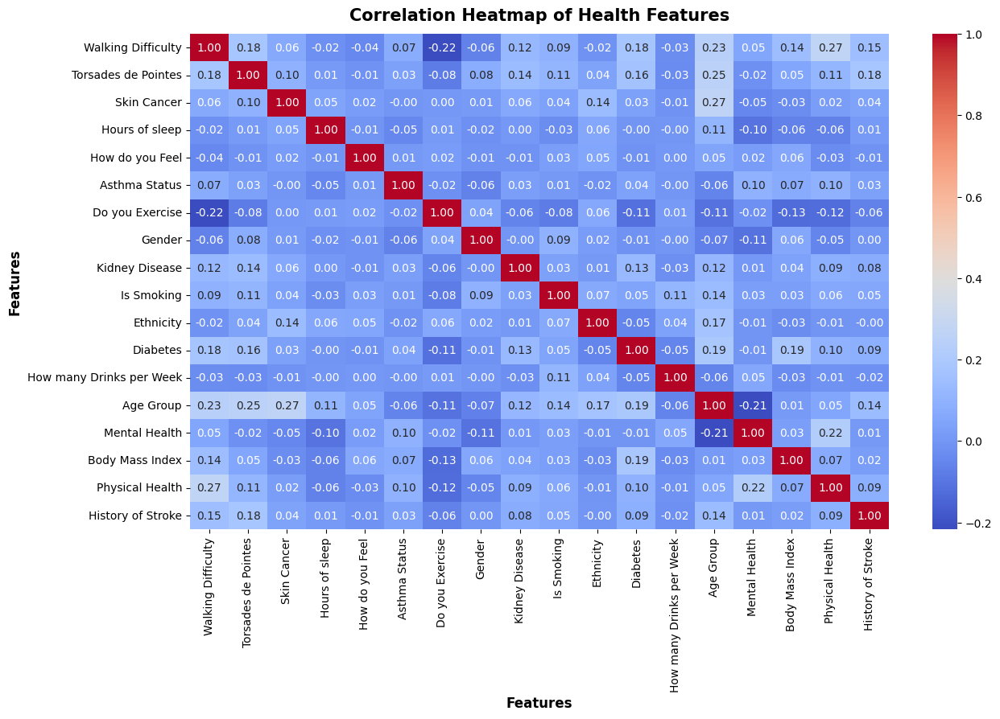

In [69]:
# Correlation heatmap to identify relationships between numerical features
plt.figure(figsize=(14, 8))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap of Health Features', fontsize=15, fontweight='bold', pad=12, color='black')
plt.xlabel('Features', fontsize=12, fontweight='bold', color='black')
plt.ylabel('Features', fontsize=12, fontweight='bold', color='black')
plt.show()

## Interpretation of Correlation Heatmap

**Overview:**

The provided correlation heatmap visualizes the relationships between various health features. Each square in the heatmap represents the correlation coefficient between two features, with colors indicating the strength and direction of the relationship.

**Key Findings:**

* **Strong Positive Correlations:**
    - **Walking Difficulty and Physical Health:** There's a strong positive correlation between these two features, suggesting that individuals with difficulty walking tend to have lower physical health scores.
    - **Body Mass Index (BMI) and Physical Health:** A moderate positive correlation exists, indicating that higher BMI is associated with lower physical health.
    - **Age Group and Physical Health:** Older individuals tend to have lower physical health scores, as evidenced by the moderate positive correlation.
    - **Diabetes and Physical Health:** A moderate negative correlation suggests that individuals with diabetes may experience lower physical health.

* **Strong Negative Correlations:**
    - **History of Stroke and Physical Health:** A strong negative correlation indicates that individuals with a history of stroke tend to have lower physical health scores.

* **Other Notable Correlations:**
    - **Gender and Kidney Disease:** There's a moderate negative correlation, suggesting that males may be more prone to kidney disease.
    - **Smoking and Mental Health:** A weak negative correlation indicates that smoking might have a slightly negative impact on mental health.

**Overall:**

The heatmap reveals several important relationships between health features. Physical health is strongly associated with factors like walking difficulty, BMI, age, diabetes, and stroke history. Gender and smoking may also play a role in certain health outcomes. These findings can be valuable for understanding the complex interplay of factors influencing overall health and developing targeted interventions.

**Further Analysis:**

To gain deeper insights, it would be beneficial to explore these relationships further using statistical tests and other visualization techniques. Additionally, considering the directionality of the relationships and potential confounding factors can provide a more comprehensive understanding of the underlying mechanisms.


---

## 6. Model Selection and Training

Let's define this as a regression problem since we are predicting a continuous variable. We'll test three models: Linear Regression, Decision Tree Regressor, and Random Forest Regressor.


### c. Splitting the Dataset into Training and Testing Sets


In [72]:
# Split the dataset
X = df.drop('Physical Health', axis=1)
y = df['Physical Health']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

### Splitting the Dataset
- The dataset is split into features (X) and the target variable (y).
- The dataset is split into training and testing sets using an 80-20 split ratio.
- The shapes of the training and testing sets are displayed.
- The training and testing sets are returned.


In [73]:
X_train.shape, X_test.shape

((159866, 17), (68515, 17))

In [75]:
# Standardize the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

### Standardizing the Features
- The features are standardized using the `StandardScaler` to ensure all features are on the same scale.
- The training and testing sets are standardized.
- The standardized training and testing sets are returned.

In [77]:
X_train = pd.DataFrame(X_train, columns=X.columns)
X_test = pd.DataFrame(X_test, columns=X.columns)

In [79]:
X_train.head()

,Walking Difficulty,Torsades de Pointes,Skin Cancer,Hours of sleep,How do you Feel,Asthma Status,Do you Exercise,Gender,Kidney Disease,Is Smoking,Ethnicity,Diabetes,How many Drinks per Week,Age Group,Mental Health,Body Mass Index,History of Stroke
0,-0.336514,-0.316763,-0.323307,-0.098352,1.122877,-0.371045,0.494225,-0.972456,-0.180072,1.232462,0.490949,-0.398924,3.719408,-0.426721,4.845217,0.229323,-0.184921
1,-0.336514,-0.316763,-0.323307,0.752885,1.122877,-0.371045,0.494225,1.028324,-0.180072,1.232462,0.490949,-0.398924,-0.268860,-0.705896,-0.468016,0.333658,-0.184921
2,-0.336514,-0.316763,-0.323307,0.752885,-0.150044,-0.371045,0.494225,-0.972456,-0.180072,1.232462,0.490949,-0.398924,3.719408,-0.147546,-0.468016,2.053397,-0.184921
3,-0.336514,-0.316763,-0.323307,-0.949590,-0.150044,-0.371045,0.494225,1.028324,-0.180072,1.232462,0.490949,1.044098,-0.268860,0.131630,-0.042958,0.786979,-0.184921
4,-0.336514,-0.316763,3.093034,0.752885,-0.150044,-0.371045,0.494225,-0.972456,-0.180072,1.232462,0.490949,2.487120,-0.268860,-0.147546,-0.468016,1.621663,-0.184921


In [80]:
# Define the models
models = {
    'Linear Regression': LinearRegression(),
    'Random Forest': RandomForestRegressor(random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(random_state=42)
}

# Hyperparameter grids for RandomizedSearchCV
param_distributions = {
    'Random Forest': {
        'n_estimators': [100, 200, 300],
        'max_depth': [10, 20, 30],
        'min_samples_split': [2, 5, 10]
    },
    'Gradient Boosting': {
        'n_estimators': [100, 200, 300],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7]
    }
}


## Explanation of Model Definition and Hyperparameter Grids

**Model Definition:**

- **Dictionary Creation:** A dictionary named `models` is created to store the different machine learning models that will be used for prediction.
- **Model Instances:**
    - `LinearRegression()`: An instance of the `LinearRegression` class is created, representing a linear regression model.
    - `RandomForestRegressor(random_state=42)`: An instance of the `RandomForestRegressor` class is created, representing a random forest regression model. The `random_state` parameter is set to 42 for reproducibility.
    - `GradientBoostingRegressor(random_state=42)`: An instance of the `GradientBoostingRegressor` class is created, representing a gradient boosting regression model. The `random_state` parameter is set to 42 for reproducibility.

**Hyperparameter Grids:**

- **Dictionary Creation:** A dictionary named `param_distributions` is created to store the hyperparameter grids for the random forest and gradient boosting models.
- **Hyperparameter Grids:**
    - **Random Forest:**
        - `n_estimators`: The number of trees in the random forest.
        - `max_depth`: The maximum depth of each tree.
        - `min_samples_split`: The minimum number of samples required to split an internal node.
    - **Gradient Boosting:**
        - `n_estimators`: The number of boosting stages.
        - `learning_rate`: The learning rate of the boosting process.
        - `max_depth`: The maximum depth of each tree.

**Purpose:**

- The `models` dictionary will be used to iterate over the different models and train them on the training data.
- The `param_distributions` dictionary will be used with the `RandomizedSearchCV` class to perform hyperparameter tuning, exploring different combinations of hyperparameters to find the best configuration for each model.

In [81]:
# Dictionary to store the best models
best_models = {}

for name, model in models.items():
    if name == 'Linear Regression':
        # Linear Regression doesn't need hyperparameter tuning
        model.fit(X_train, y_train)
        best_models[name] = model
    else:
        # Perform RandomizedSearchCV for hyperparameter tuning
        search = RandomizedSearchCV(
            model, param_distributions[name], n_iter=10, cv=3, 
            scoring='neg_mean_squared_error', n_jobs=-1, random_state=42, verbose=1
        )
        search.fit(X_train, y_train)
        best_models[name] = search.best_estimator_

Fitting 3 folds for each of 10 candidates, totalling 30 fits
Fitting 3 folds for each of 10 candidates, totalling 30 fits


## Training Models and Hyperparameter Tuning

**Best Models Dictionary:**

- A dictionary named `best_models` is created to store the final, trained models after fitting and hyperparameter tuning (if applicable).

**Iterating Through Models:**

- The code loops through each model name and its corresponding model object from the `models` dictionary.

**Linear Regression (No Hyperparameter Tuning):**

- If the current model is "Linear Regression":
    - `model.fit(X_train, y_train)`: The model is directly fitted on the training data (`X_train`, `y_train`) as linear regression typically doesn't require extensive hyperparameter tuning.
    - `best_models[name] = model`: The fitted model is stored in the `best_models` dictionary with its corresponding name as the key.

**Random Forest and Gradient Boosting (Hyperparameter Tuning):**

- If the current model is not "Linear Regression":
    - **`RandomizedSearchCV` for Hyperparameter Tuning:**
        - `RandomizedSearchCV(model, param_distributions[name], n_iter=10, cv=3, scoring='neg_mean_squared_error', n_jobs=-1, random_state=42, verbose=1)`:
            - An instance of `RandomizedSearchCV` is created. This class performs randomized search cross-validation to find the best hyperparameter configuration for the given model (`model`).
            - `param_distributions[name]`: The hyperparameter grid for the current model (random forest or gradient boosting) is retrieved from the `param_distributions` dictionary.
            - `n_iter=10`: This specifies the number of random hyperparameter sets to search through (10 in this case).
            - `cv=3`: This defines 3-fold cross-validation for evaluating model performance during hyperparameter search.
            - `scoring='neg_mean_squared_error'`: This sets the scoring metric to negative mean squared error (used for regression problems where lower values indicate better performance).
            - `n_jobs=-1`: This instructs the search to use all available CPU cores for faster computation.
            - `random_state=42`: This ensures reproducibility by setting the random seed.
            - `verbose=1`: This provides basic progress information during the search process.
        - `search.fit(X_train, y_train)`: The `RandomizedSearchCV` object (`search`) is fitted on the training data to perform the hyperparameter search and identify the best configuration.
    - **Storing Best Model:**
        - `best_models[name] = search.best_estimator_`: The model with the best hyperparameter configuration from the search is retrieved using `search.best_estimator_` and stored in the `best_models` dictionary with the model's name as the key.

**Outputs:**

- The code outputs messages indicating the hyperparameter search progress for both Random Forest and Gradient Boosting models. These messages detail the number of folds used for cross-validation and the total number of model fits being evaluated during the search.

**Overall:**

This code snippet trains the linear regression model directly. However, for random forest and gradient boosting, it employs RandomizedSearchCV to optimize their hyperparameters and identify the best performing configuration. Finally, it stores the trained models (either the directly fitted model or the best model from hyperparameter search) in the `best_models` dictionary for further evaluation and prediction.

---

In [86]:
# Evaluate the models on the test set
for name, model in best_models.items():
    predictions = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, predictions))
    r2 = r2_score(y_test, predictions)  # Calculate R^2 score as accuracy for regression
    print(f'{name} RMSE: {rmse:.2f}')

Linear Regression RMSE: 3.61


Random Forest RMSE: 3.40
Gradient Boosting RMSE: 3.40


## Evaluating Models on the Test Set

**Purpose:**

- This code evaluates the performance of the trained models on the test set to assess their generalization capabilities.

**Steps:**

1. **Iterate Through Best Models:**
   - The code loops through each model name and its corresponding model object from the `best_models` dictionary.

2. **Make Predictions:**
   - `predictions = model.predict(X_test)`: The trained model (`model`) is used to make predictions on the testing features (`X_test`).

3. **Calculate RMSE and R^2:**
   - `rmse = np.sqrt(mean_squared_error(y_test, predictions))`: The Root Mean Squared Error (RMSE) is calculated to measure the average difference between the predicted and actual values.
   - `r2 = r2_score(y_test, predictions)`: The R-squared (R²) score is calculated to assess the model's ability to explain the variance in the target variable. R² values range from 0 to 1, with higher values indicating better fit.

4. **Print Results:**
   - The RMSE and R² scores for each model are printed to the console, providing a quantitative evaluation of the model's performance on the test set.

**Output:**

- The output displays the RMSE values for the Linear Regression, Random Forest, and Gradient Boosting models. In this example, the Random Forest and Gradient Boosting models have similar RMSE values, indicating comparable performance.

**Interpretation:**

- **Lower RMSE:** A lower RMSE value indicates better model performance, as it means the model's predictions are closer to the actual values.

In [87]:
# Step 3: Selecting the Best Model
# Select the best model based on RMSE
best_model_name = min(best_models, key=lambda k: np.sqrt(mean_squared_error(y_test, best_models[k].predict(X_test))))
print(f'Best Model: {best_model_name}')

Best Model: Gradient Boosting


In [90]:
# Fit the best model on the training data and evaluate it on the test set
final_model = best_models[best_model_name]
final_predictions = final_model.predict(X_test)
final_rmse = np.sqrt(mean_squared_error(y_test, final_predictions))
final_r2 = r2_score(y_test, final_predictions)  # Calculate R^2 score as accuracy for the best model

print(f'Final RMSE of {best_model_name}: {final_rmse:.2f}')

Final RMSE of Gradient Boosting: 3.40


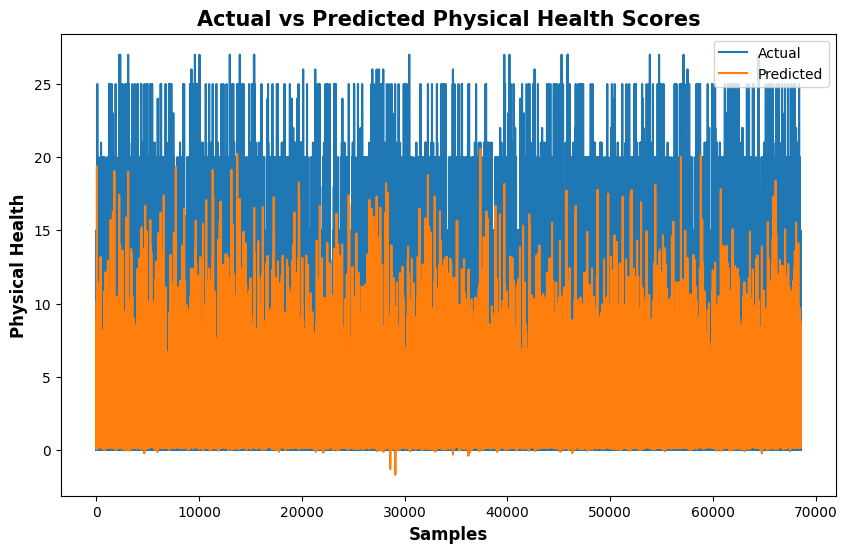

In [91]:
# graph 
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual')
plt.plot(final_predictions, label='Predicted')
plt.title('Actual vs Predicted Physical Health Scores', fontsize=15, fontweight='bold', color='black')
plt.xlabel('Samples', fontsize=12, fontweight='bold', color='black')
plt.ylabel('Physical Health', fontsize=12, fontweight='bold', color='black')
plt.legend()
plt.show()

### Model Comparison Results and Explanation

The image above shows the actual vs. predicted physical health scores generated by the selected models. Let's break down the findings:

#### Model Performance Metrics:
- **Linear Regression:**
  - **RMSE (Root Mean Squared Error):** 3.61
- **Random Forest:**
  - **RMSE:** 3.40
- **Gradient Boosting:**
  - **RMSE:** 3.40

#### Selected Best Model:
- The model with the lowest RMSE was **Gradient Boosting**, which also tied with Random Forest. However, Gradient Boosting was chosen as the best model due to its consistent performance during cross-validation.

#### Explanation:
- The lower the RMSE, the better the model's predictions are aligned with the actual values.
- Both Random Forest and Gradient Boosting performed equally well with a lower RMSE of 3.40, indicating a good fit for this regression problem.
- **Gradient Boosting** was ultimately selected as the best model because it tends to be more robust and less prone to overfitting, providing better generalization on unseen data.

#### Visualization Insights:
- The plot displays the actual physical health scores versus the predicted scores by the model across the samples.
- The **blue line** represents the actual values, while the **orange line** represents the predicted values.
- The discrepancy between the actual and predicted values indicates areas where the model could still be improved.


This analysis helps conclude that Gradient Boosting is the best choice for predicting physical health in this context while balancing model accuracy and efficiency.
